# 1. Load packages

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt



## define location to save figures

In [2]:
figure_folder = r'L:\Shiwei\RNA_MERFISH_analysis\Merged_nonclear'
print(figure_folder)
if not os.path.exists(figure_folder):
    os.makedirs(figure_folder)
    
    
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figs ize=(4, 4), fontsize=8, facecolor='white', transparent=True)
sc.settings.figdir = figure_folder

L:\Shiwei\RNA_MERFISH_analysis\Merged_nonclear


# 2. Load MERFISH decoded data

MERFISH decoded data can be generated from the raw image data by MERlin from below:

https://github.com/ZhuangLab/MERlin


In [3]:
data_folders= [r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220304-storm6_M1', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220329-storm6_M1', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220415-storm65', 
               r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\v2\20220418-storm6',
              ]

adata_list = []
for _data_folder in data_folders:
    
    cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
    cell_meta_data = pd.read_csv(cell_meta_data_file)
    counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
    df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
    for _c in df.columns:
        if 'Blank-' in _c:
            df = df.drop(columns=_c)
    adata = anndata.AnnData(df)
    adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
    adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
    
    #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
    #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
    #_data = sc.read(_save_filename)
    adata_list.append(adata)
    

C:\Users\shiwei\AppData\Local\Temp\2\ipykernel_13700\376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\shiwei\AppData\Local\Temp\2\ipykernel_13700\376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\shiwei\AppData\Local\Temp\2\ipykernel_13700\376269533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the 

In [4]:
# concat all data
merged_adata = anndata.concat(adata_list, )

# 3. Preprocess and filter the MERFISH data 

In [5]:
merged_adata.obs

,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y,experiment
Unnamed: 0,,,,,,,,,
103420171094780316930229829293672994552,0,417.766477,-6160.785804,3859.737498,-6164.846604,-6156.725004,3856.600098,3862.874898,20220304
103489270985795086009915676188840872439,0,403.121799,-5984.643199,3962.926100,-5989.562599,-5979.723799,3956.597300,3969.254901,20220304
110378182762178985048480349573428085184,0,311.350434,-6060.669801,3935.332100,-6067.106601,-6054.233001,3932.297300,3938.366900,20220304
113811790893231448949429397438012891173,0,1345.443053,-6046.845801,3943.378100,-6056.090601,-6037.601000,3938.129300,3948.626900,20220304
119547840309256440899855144626134392385,0,866.273544,-6009.207800,3915.406099,-6014.078600,-6004.337000,3910.049299,3920.762899,20220304
...,...,...,...,...,...,...,...,...,...
89693667447381166825974211066546027108,199,902.828639,716.167977,-479.046023,710.973176,721.362777,-487.264823,-470.827222,20220418
91438720578084772766153254208668721365,199,1384.815587,773.245978,-440.382022,763.353178,783.138778,-448.492822,-432.271221,20220418
9309655717966444417466699177656147218,199,683.492590,767.089978,-403.446021,762.381178,771.798778,-409.072821,-397.819220,20220418


## 3.1 Basic QC and filtering

In [6]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

In [7]:
merged_adata.var

,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts
1700022I11Rik,4902,0.066538,93.985424,5423.0
1810046K07Rik,7232,0.108721,91.126598,8861.0
5031425F14Rik,4203,0.058134,94.843071,4738.0
5730522E02Rik,7672,0.118132,90.586734,9628.0
Acta2,16213,0.451486,80.107237,36797.0
...,...,...,...,...
Vtn,7110,0.491583,91.276288,40065.0
Vwc2,12503,0.349464,84.659272,28482.0
Wipf3,43420,10.881291,46.725234,886847.0
Wnt7b,19885,0.710940,75.601826,57943.0


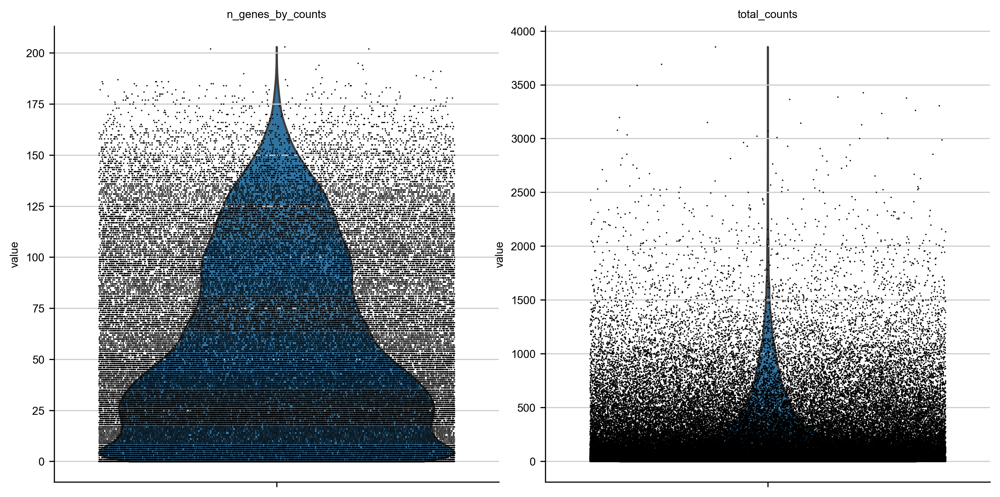

In [8]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

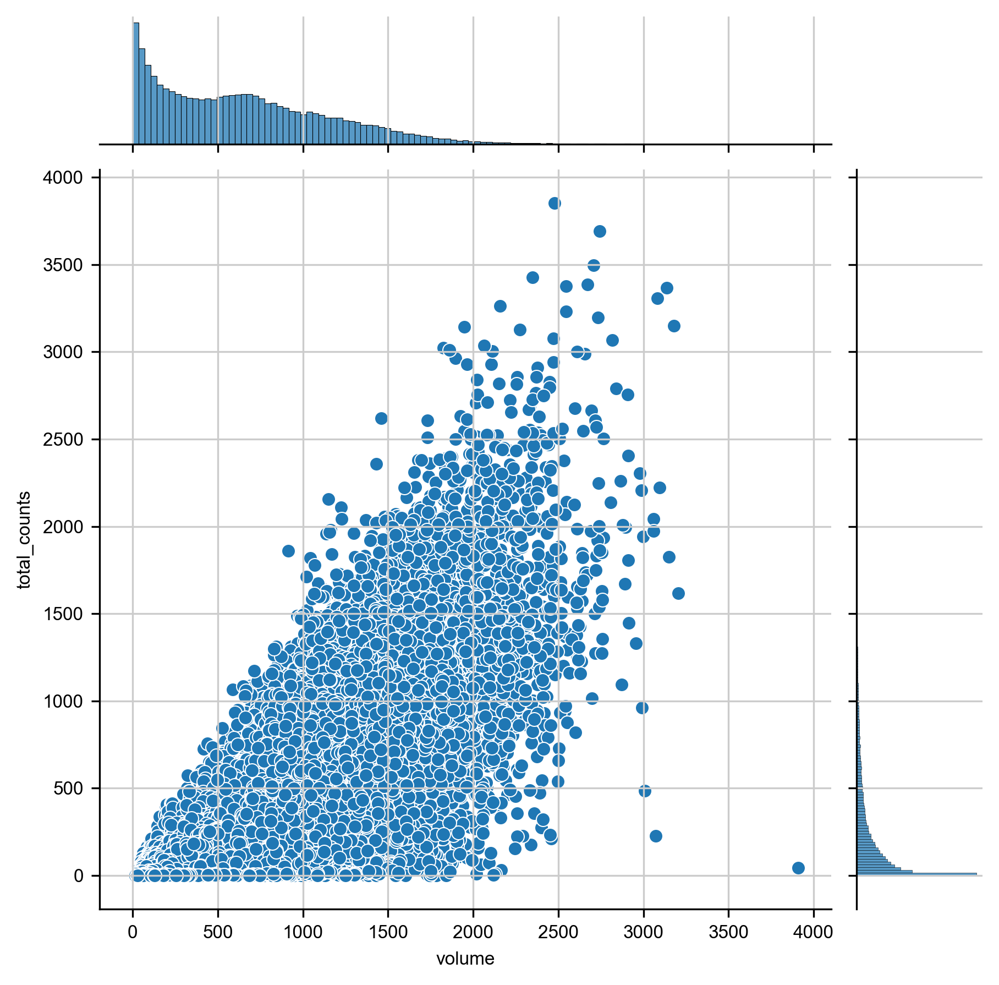

In [9]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts')

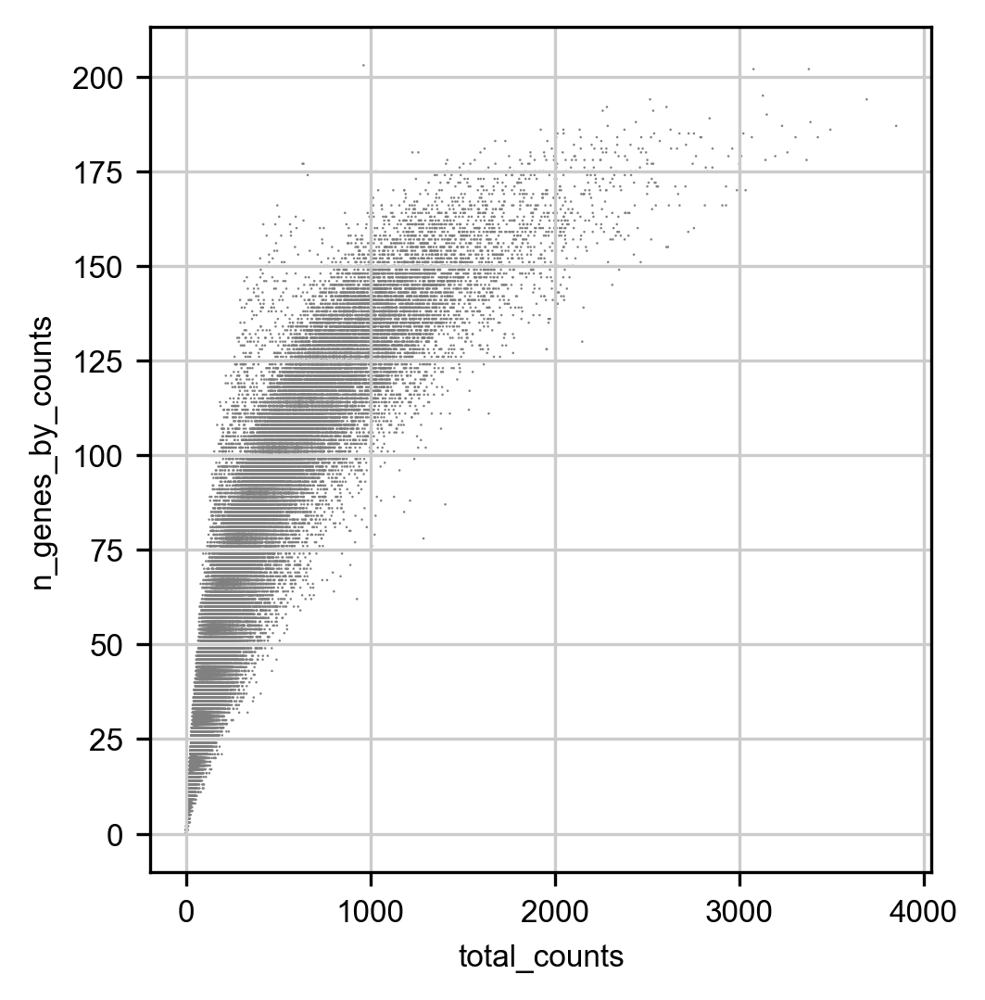

In [10]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [11]:
print(len(merged_adata))

81502


In [12]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

63431


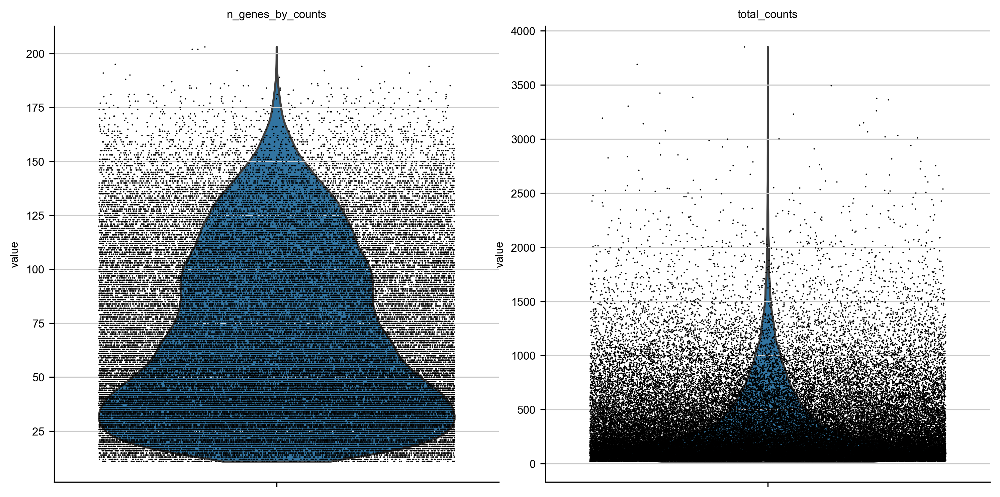

In [13]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [14]:
np.mean(merged_adata.obs['total_counts'])

355.30362

## 3.2 Filter doublet

In [17]:
len(merged_adata)

63431

In [16]:
sc.external.pp.scrublet(merged_adata)

C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.82
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\external\pp\_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']


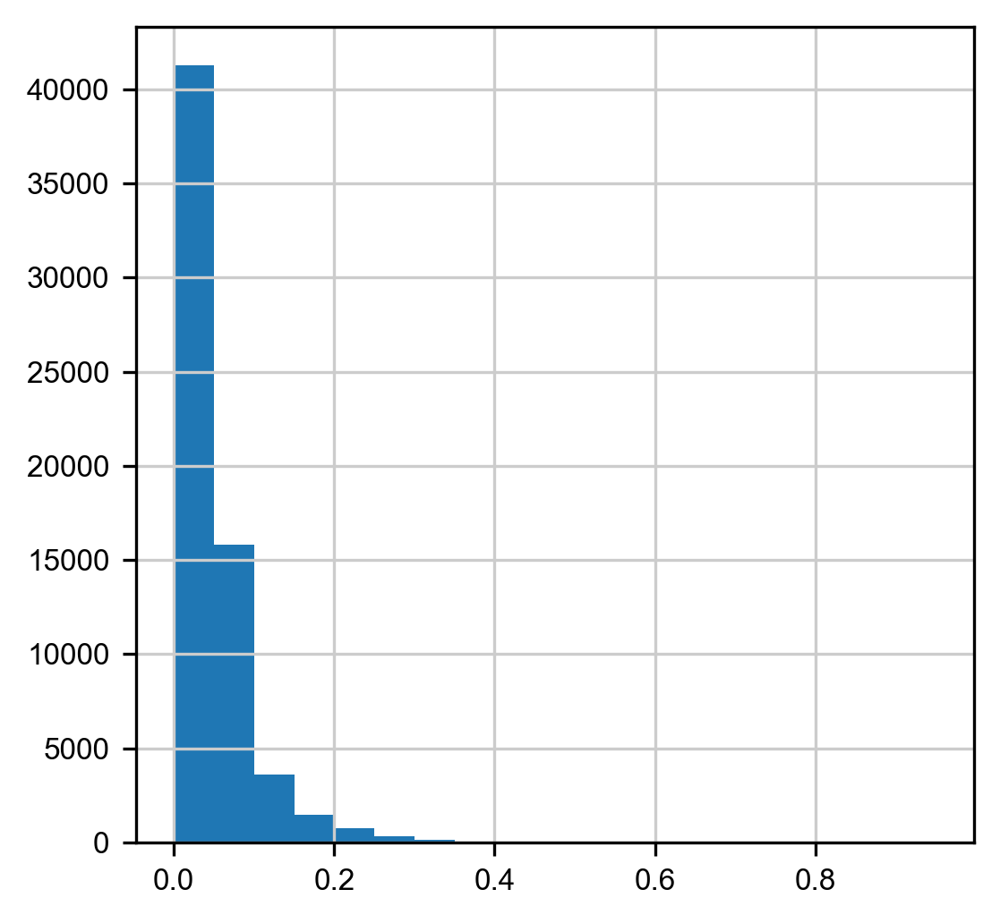

0.0037048131040027747

In [18]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()
np.mean(merged_adata.obs['doublet_score'] > 0.3)

In [19]:
# remove potential doublet
doublet_score_th = 0.3
merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

63196

## 3.2.1 Save the filtered unnormlaized data (optional)

In [20]:
save_folder = r'L:\Shiwei\RNA_MERFISH_analysis\Merged_nonclear'
save_filename = os.path.join(save_folder, 'filtered_unnorm_data.h5ad')

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: L:\Shiwei\RNA_MERFISH_analysis\Merged_nonclear\filtered_unnorm_data.h5ad


## 3.3 Save raw data to adata.raw

In [21]:
# save raw adata before normalization

merged_adata.raw = merged_adata

# proceed with the log1p transformed data for clustering visualization 

## 3.4 Normalization and scaling

In [23]:
np.median(merged_adata.obs['total_counts'])

216.0

In [24]:
# library size control; normalize to the median

sc.pp.normalize_total(merged_adata, target_sum= 200 )

## 3.5 Log1p, regress, and clip std

In [25]:
# log1p to scale the counts to center around 0
# log(1+x) 
#  The +1 makes sure that 0 values in the original data still map to 0 in log space (and prevents us from trying to take the log of 0). This makes the expression values more closely approximate a Gaussian distribution, 
#which is an assumption inherent to many downstream analysis methods
sc.pp.log1p(merged_adata)

In [26]:
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')  # because it appears the detection efficiency is also determing the numbber
# Convert gene expressions to Z-scores
# Clip values exceeding standard deviation 10.
sc.pp.scale(merged_adata, max_value=10)  

# 4. PCA and UMAP of the MERFISH data (for quick test)

## 4.1 PCA and UMAP

C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


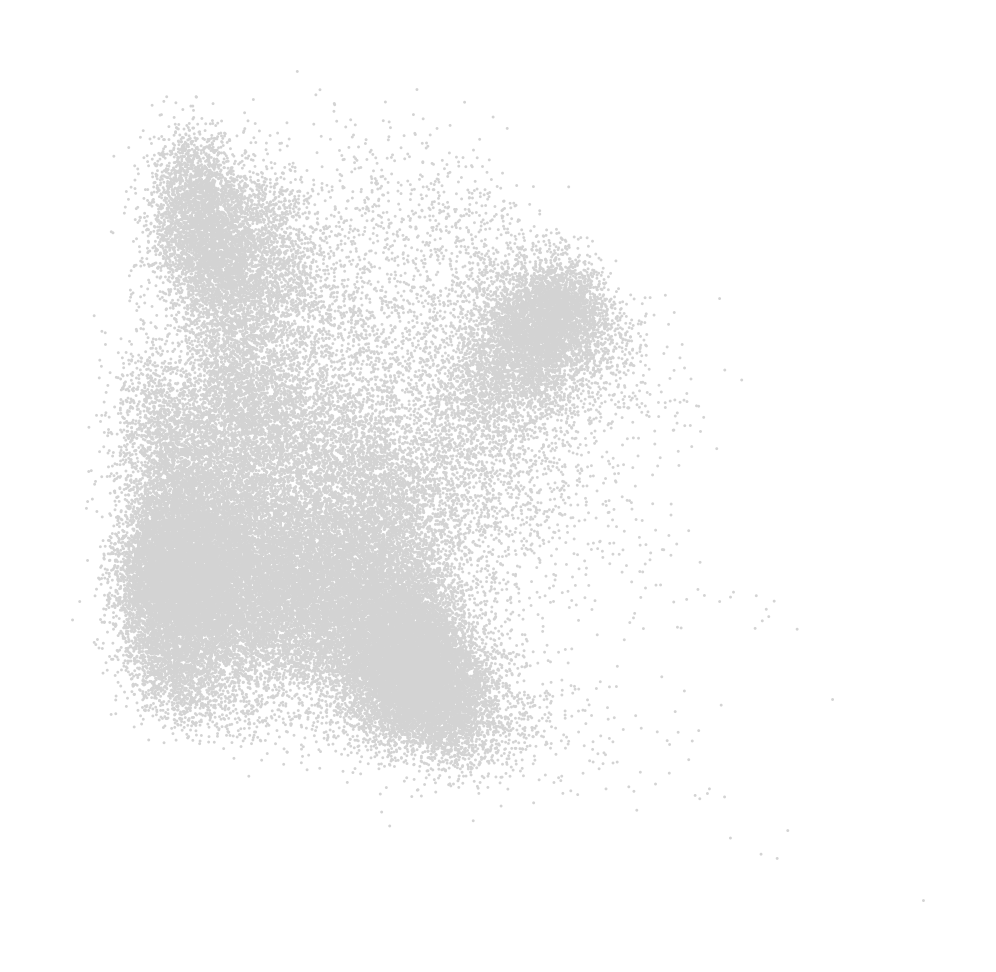

CPU times: total: 12 s
Wall time: 1.13 s


In [27]:
%%time

# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata)

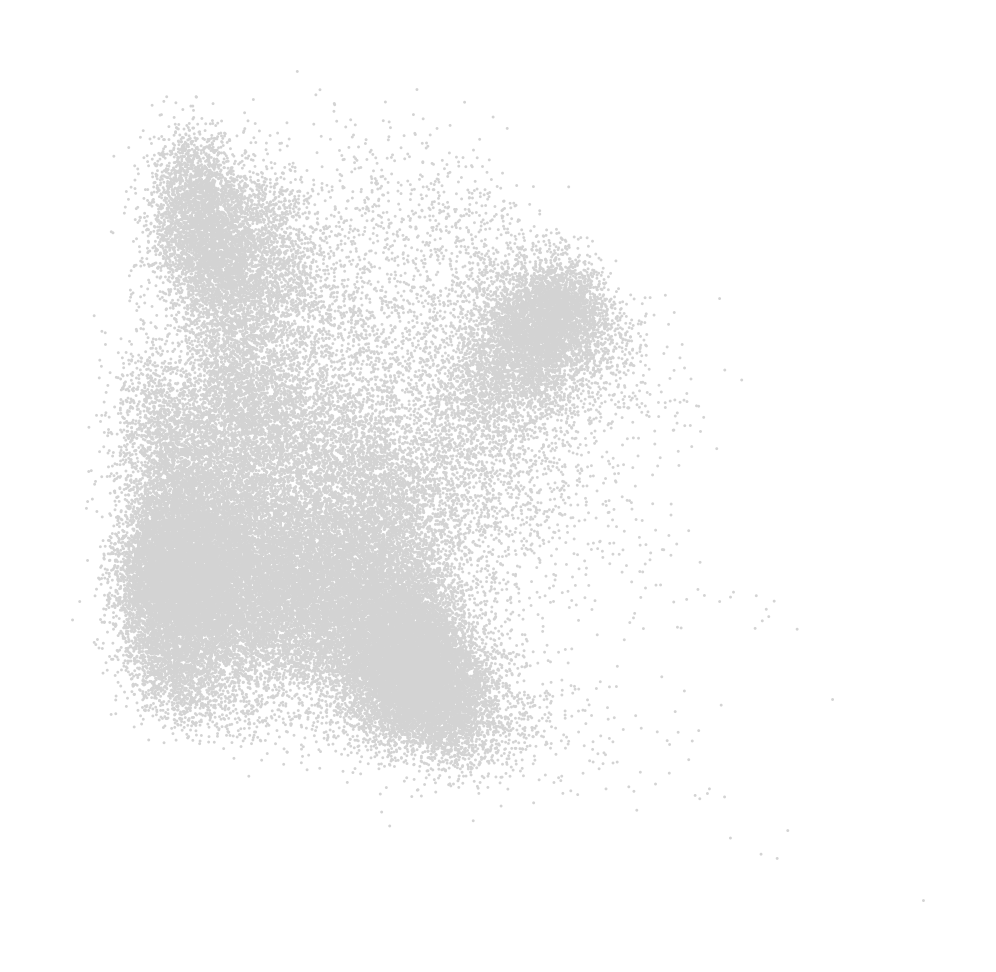

C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 8942 (\N{VERTICAL ELLIPSIS}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


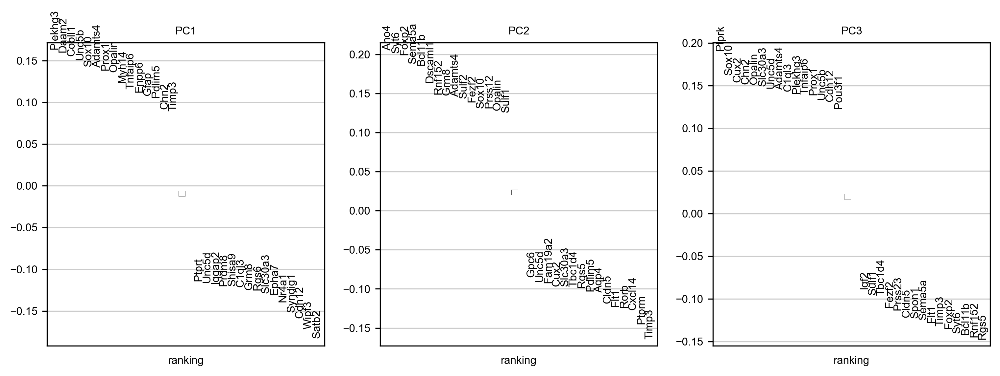

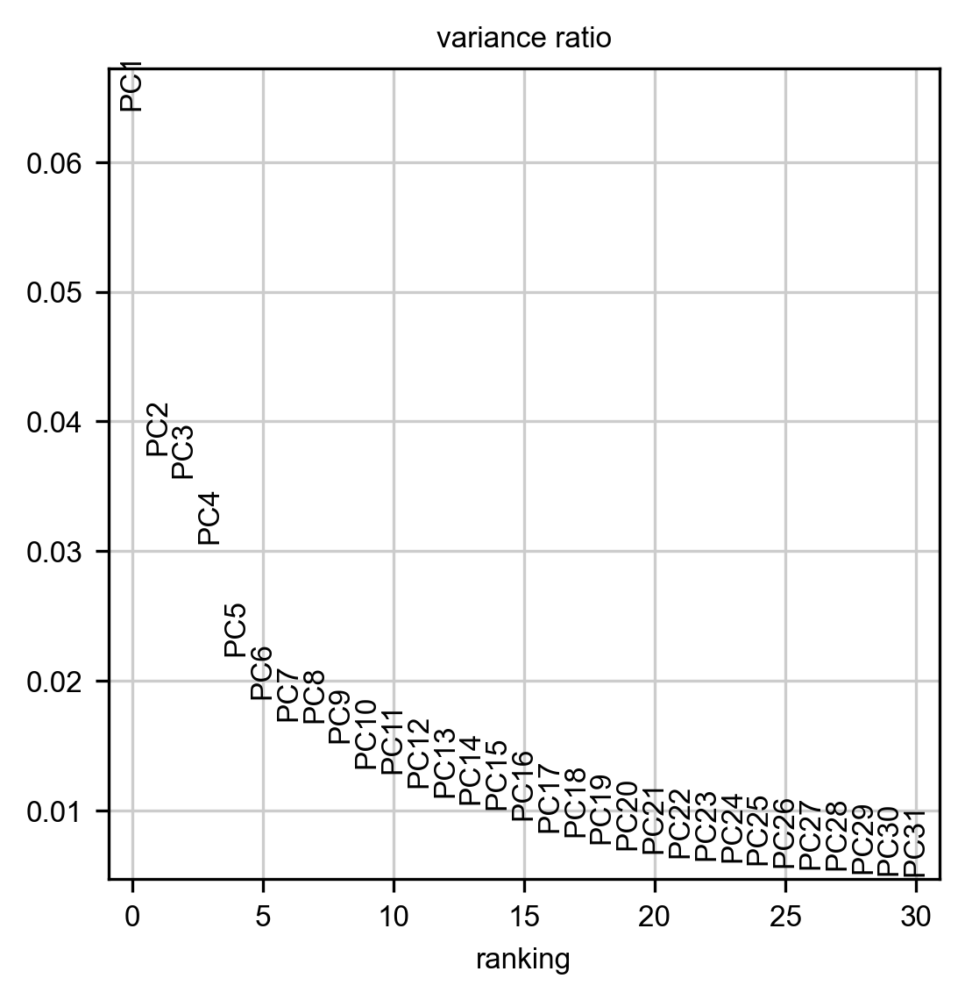

In [28]:
# Check PC's contribution
sc.pl.pca_overview(merged_adata)

In [29]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=10, n_pcs=30)
# Clustering
sc.tl.leiden(merged_adata, resolution=0.5)

C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


CPU times: total: 50.1 s
Wall time: 32.7 s


C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


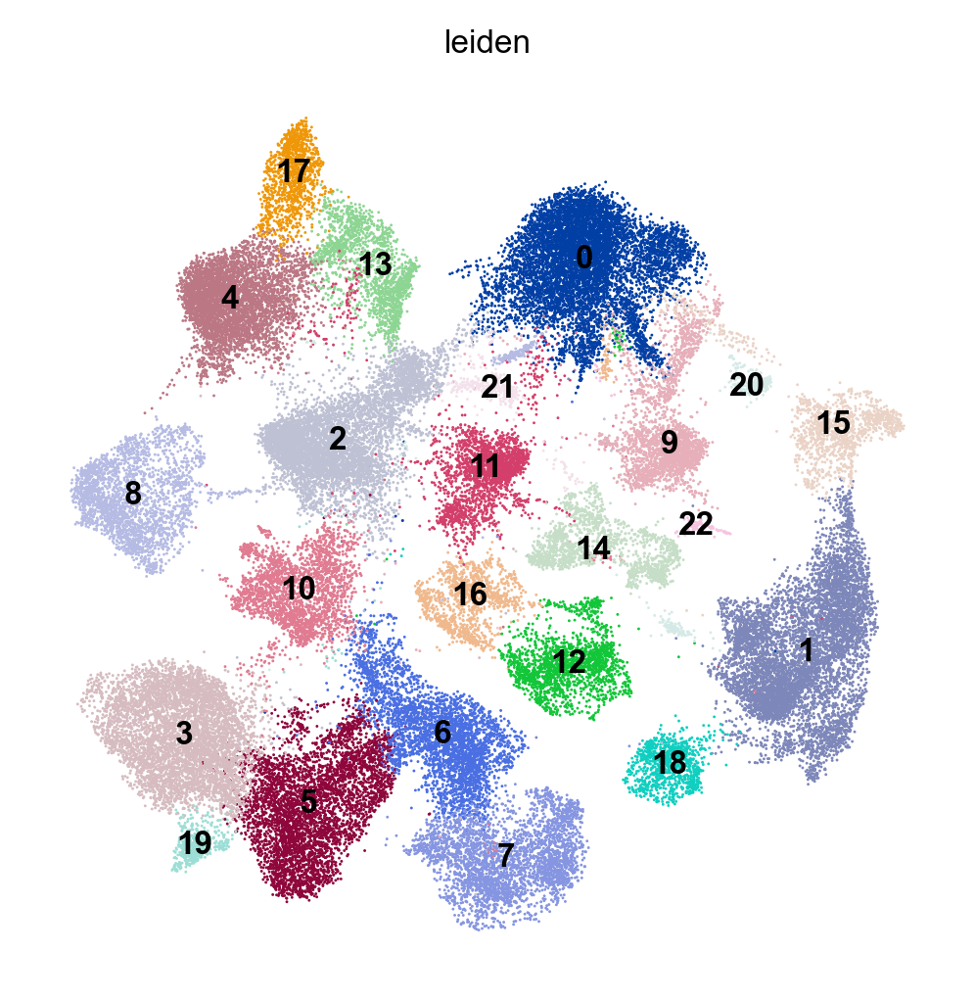

CPU times: total: 1min 55s
Wall time: 50.9 s


In [30]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

In [34]:
merged_adata.obs['leiden_subclass'] = merged_adata.obs.leiden

## 4.2 check reproduciblilty between replicate

C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


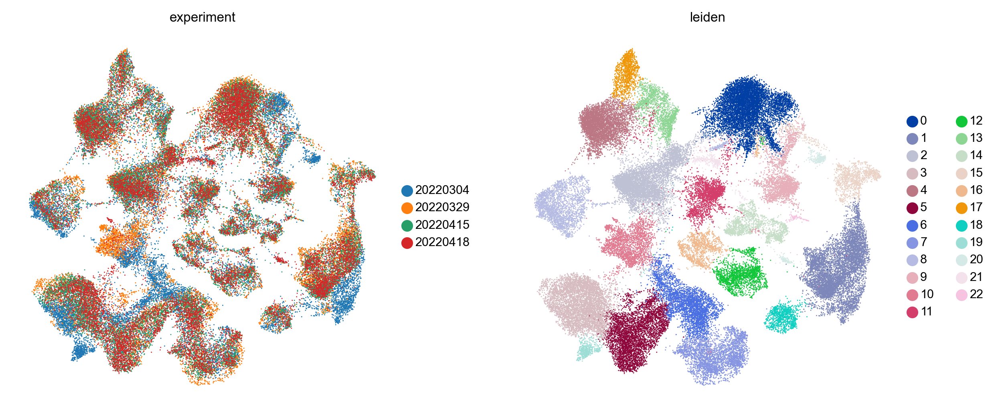

In [32]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color=['experiment', 'leiden'] )

C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\shiwei\Anaconda3\envs\shiwei_chromatin\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


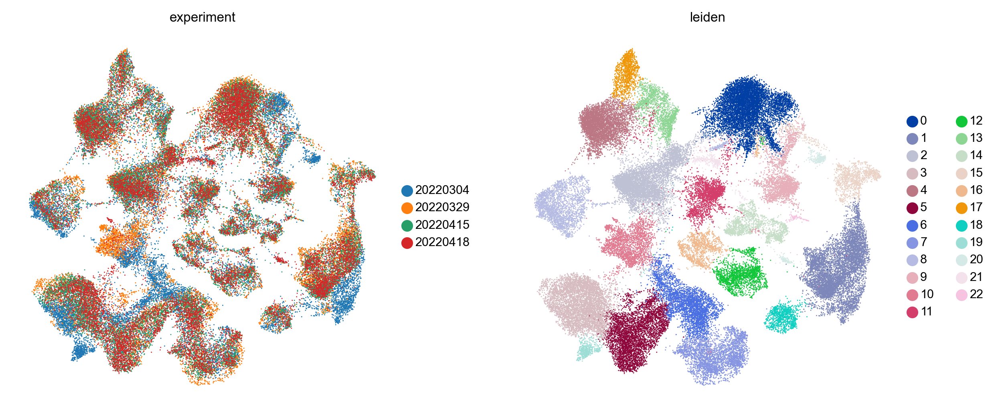

In [33]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color=['experiment', 'leiden'] )

## 4.3. Check count for each cell for genes of interest

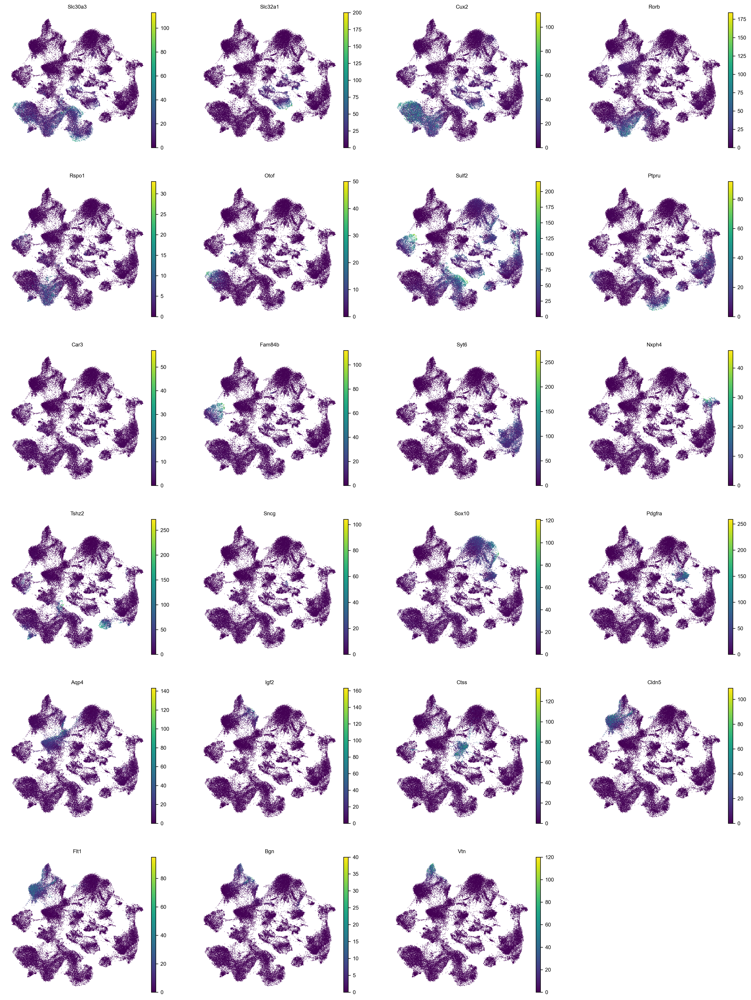

In [35]:
# Visualize marker genes
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in merged_adata.var.index)]

sc.pl.umap(merged_adata, color=marker_genes)

# 5. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [36]:
save_folder = r'L:\Shiwei\RNA_MERFISH_analysis\Merged_nonclear'
save_filename = os.path.join(save_folder, 'filtered_cluster_data_20230215.h5ad')
#save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')
overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: L:\Shiwei\RNA_MERFISH_analysis\Merged_nonclear\filtered_cluster_data_20230215.h5ad
